In [1]:
from tensorflow import keras
import tensorflow_datasets as tfds
import tensorflow as tf
from keras.layers import (Input, Dense, Conv2D, Conv2DTranspose, BatchNormalization, UpSampling2D, LeakyReLU,
                          Dropout, Flatten, Reshape, Lambda, MaxPool2D, RandomContrast, Concatenate, add, Cropping2D)
from keras.models import Model
from keras.optimizers import RMSprop, Adam
from math import log2
import matplotlib.pyplot as plt
from random import randint
import numpy as np

In [2]:
# Константы
img_side = 256

# Разбиваем датасет на тренировочную группу и группу валидации
def init_data_with_batch_size(batch_size):
    global train_data, val_data
    train_data = tf.keras.utils.image_dataset_from_directory(
        # Чтобы использовать "new_flowers" (расширенный датасет) надо запустить increasing_data.py
        "flowers",
        image_size=(img_side, img_side),
        shuffle=True,
        batch_size=batch_size,

        subset="training",
        validation_split=0.1,
        seed=42,
    )
    val_data = tf.keras.utils.image_dataset_from_directory(
        # Чтобы использовать "new_flowers" (расширенный датасет) надо запустить increasing_data.py
        "flowers",
        image_size=(img_side, img_side),
        shuffle=True,
        batch_size=batch_size,

        subset="validation",
        validation_split=0.1,
        seed=42,
    )

    # Убираем лейблы (т.к. у нас задача не распознавать изображения)
    train_data = train_data.map(lambda x, y: (x/255., x/255.))
    val_data = val_data.map(lambda x, y: (x/255., x/255.))

    return train_data, val_data

Модель

In [3]:
# Константы
dropout = 0.05
dense_factor = 32    # Какую часть картинки обрабатываем Dense (4**2 == четверть картинки)

filters = 4          # Нижняя граница
hidden_units = 4**5  # Только степень 4 (4**?) (Размер "смыслового вектора")

amount_encode_layers = 4
amount_decode_layers = 4
max_boudle_residual_layers = 2  # Сколько слоёв с остаточноым обучением ПЕРЕД уменьшением/увеличением картинки

input_img = Input(shape=(img_side, img_side, 3))

"""Энкодер"""
# Это надо чтобы первый слой мог сложиться со следующим (при помощи add([x_temp, x]) )
x_temp = Conv2D(filters*2**amount_encode_layers, (3, 3), activation=LeakyReLU(0.1), padding="same")(input_img)

for i in range(amount_encode_layers, 0, -1):
    for _ in range(max_boudle_residual_layers):
        x = Conv2D(filters * 2**i, (3, 3), activation=LeakyReLU(0.1), padding="same")(x_temp)
        x = Conv2D(filters * 2**i, (3, 3), activation=LeakyReLU(0.1), padding="same")(x)
        x_temp = add([x_temp, x])

    x = MaxPool2D()(x_temp)
    x_temp = Conv2D(filters * 2**(i - 1), (3, 3), activation=LeakyReLU(0.1), padding="same")(x)
encoder_output = x_temp

encoder = Model(input_img, encoder_output, name="encoder")
hidden_shape = [*encoder_output.shape[1:]]


"""Декодер"""
decoder_input = Input(hidden_shape)
x_temp = Conv2D(filters, (3, 3), activation=LeakyReLU(0.1), padding="same")(decoder_input)

# Расширяем карту признаков, увеличиваем картинку и количество фильтров
for i in range(amount_decode_layers):
    for _ in range(max_boudle_residual_layers):
        x = Conv2D(filters * 2**i, (3, 3), activation=LeakyReLU(0.1), padding="same")(x_temp)
        x = Conv2D(filters * 2**i, (3, 3), activation=LeakyReLU(0.1), padding="same")(x)
        x_temp = add([x_temp, x])

    # Чтобы количество фильтров совпадало (для остаточного обучения)
    x_temp = Conv2DTranspose(filters * 2**(i + 1), (3, 3), activation=LeakyReLU(0.1), padding="same", strides=2)(x_temp)
x = x_temp

# Постепенно уменьшаем количество фильтров
for i in range(int(log2(x.shape[-1])), 1, -1):
    x = Conv2D(2**i, (3, 3), activation=LeakyReLU(0.1), padding="same")(x)

x = Conv2D(3, (3, 3), activation="sigmoid", padding="same")(x)

# Увеличиваем чёткость при помощи Dense (берём кусочек картинки)
# (проходимся по каждому каналу отдельно)
x = Reshape((3 * dense_factor, img_side**2 // dense_factor))(x)
x = Dropout(dropout)(x)
x = Dense(img_side**2 // dense_factor, activation="sigmoid")(x)
x = Reshape((img_side, img_side, 3))(x)

decoder = Model(decoder_input, x, name="decoder")

# Модель
vae = Model(input_img, decoder(encoder(input_img)), name="vae")
vae.compile(
    optimizer=keras.optimizers.Adam(1e-3),
    loss="binary_crossentropy",
    loss_weights=[1000],
)

vae.summary()

Model: "vae"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 256, 256, 3)]     0         
                                                                 
 encoder (Functional)        (None, 16, 16, 4)         222652    
                                                                 
 decoder (Functional)        (None, 256, 256, 3)       16916839  
                                                                 
Total params: 17,139,491
Trainable params: 17,139,491
Non-trainable params: 0
_________________________________________________________________


In [5]:
train_data, val_data = init_data_with_batch_size(16)
vae.fit(
    train_data,
    epochs=100,
    validation_data=val_data,
)

Found 2799 files belonging to 5 classes.
Using 2520 files for training.
Found 2799 files belonging to 5 classes.
Using 279 files for validation.
Epoch 1/100
360/360 [==============================] - 219s 603ms/step - loss: 562.0869 - val_loss: 525.3491
Epoch 2/100
360/360 [==============================] - 216s 600ms/step - loss: 526.8505 - val_loss: 515.3840
Epoch 3/100
360/360 [==============================] - 216s 600ms/step - loss: 521.0666 - val_loss: 517.0032
Epoch 4/100
360/360 [==============================] - 216s 600ms/step - loss: 515.4459 - val_loss: 503.9207
Epoch 5/100
360/360 [==============================] - 216s 600ms/step - loss: 502.7746 - val_loss: 491.6696
Epoch 6/100
360/360 [==============================] - 216s 600ms/step - loss: 497.1451 - val_loss: 486.7190
Epoch 7/100
360/360 [==============================] - 216s 600ms/step - loss: 493.6194 - val_loss: 488.2159
Epoch 8/100
360/360 [==============================] - 216s 600ms/step - loss: 492.5325 - va

KeyboardInterrupt: 

Found 2799 files belonging to 5 classes.
Using 2520 files for training.
Found 2799 files belonging to 5 classes.
Using 279 files for validation.


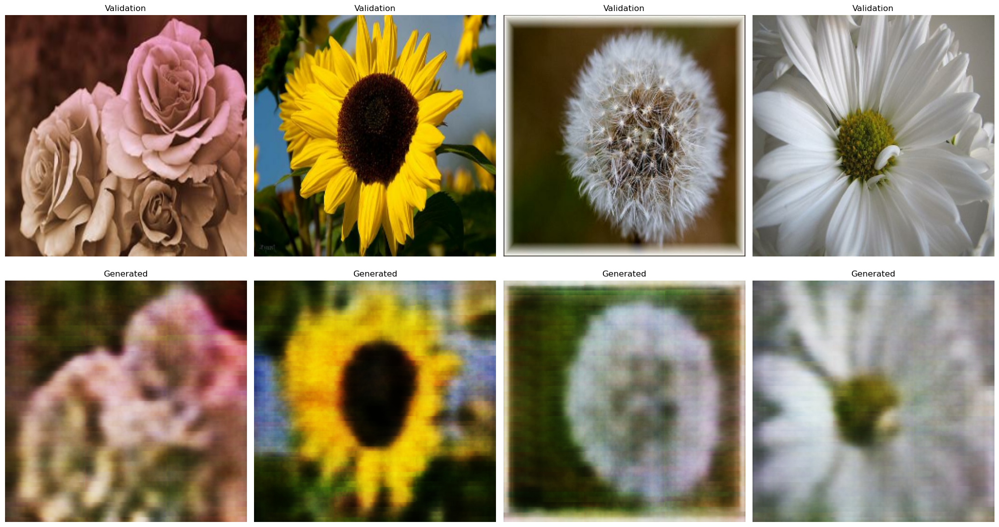

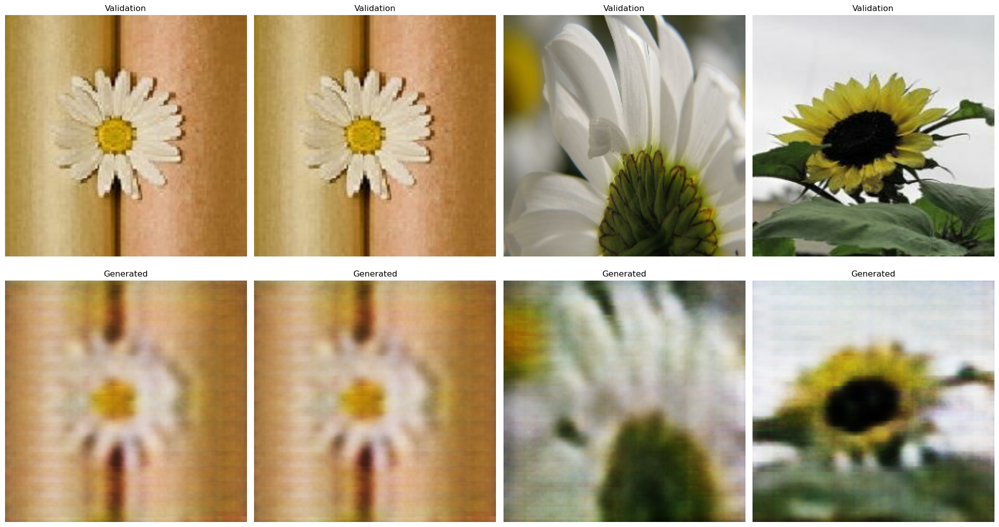

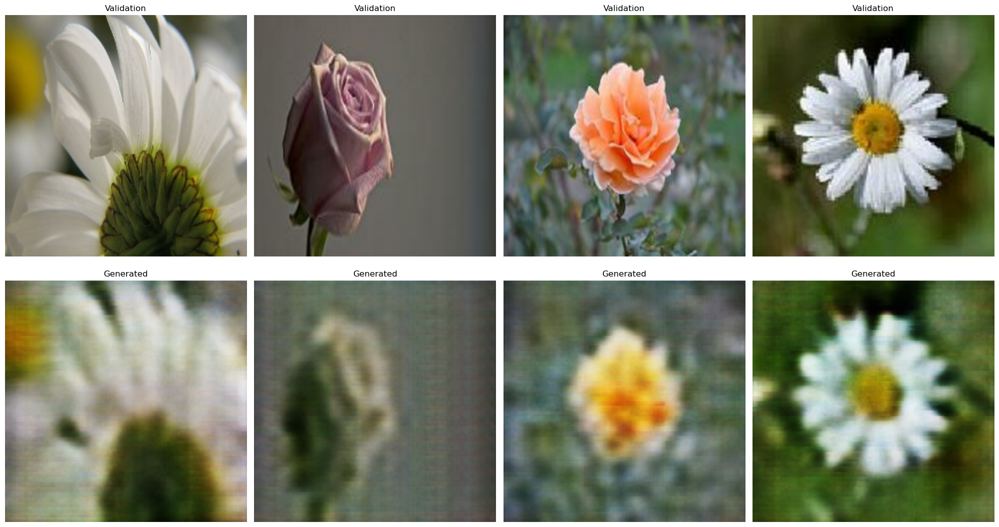

Found 2799 files belonging to 5 classes.
Using 2520 files for training.
Found 2799 files belonging to 5 classes.
Using 279 files for validation.


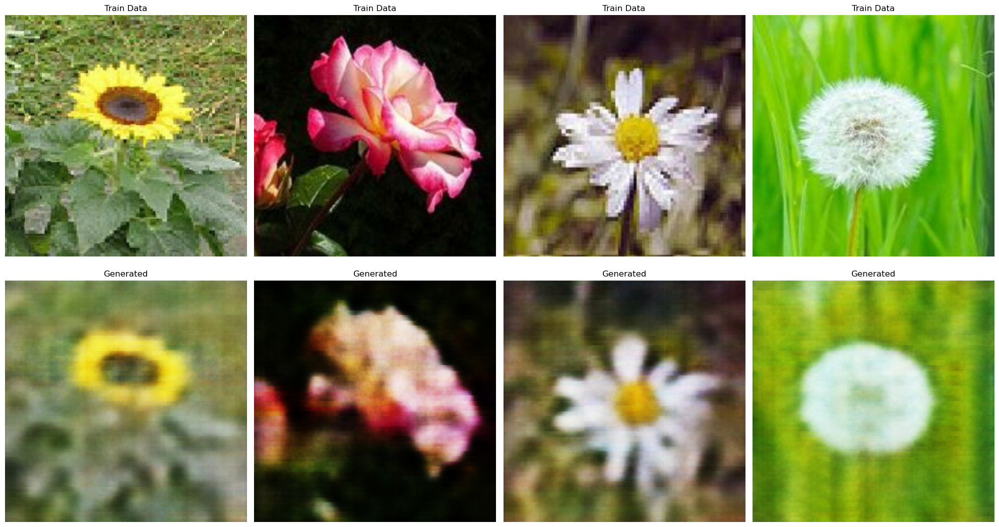

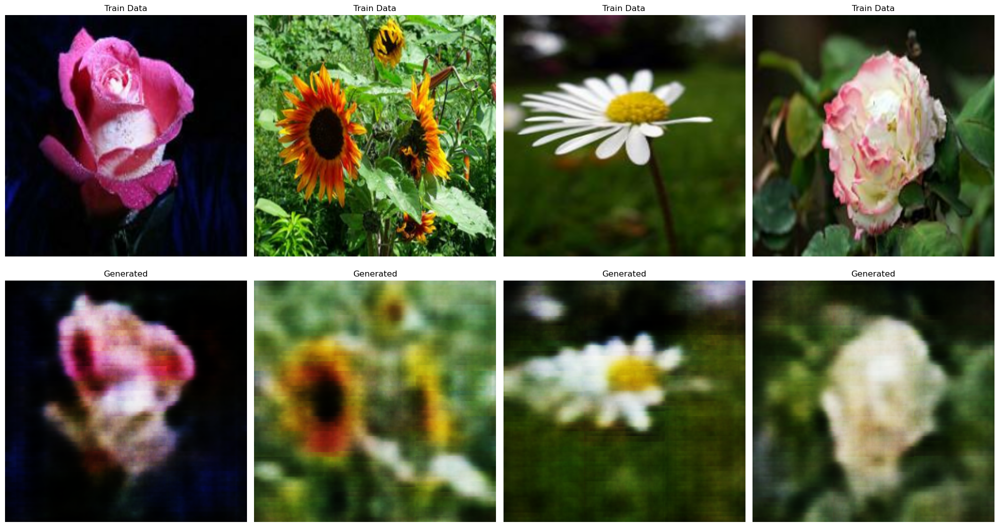

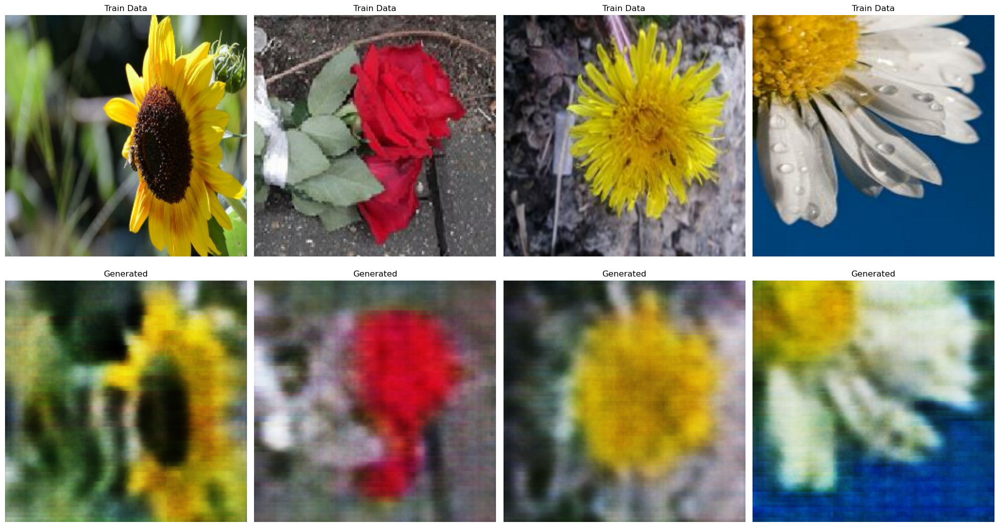

In [75]:
def show_row_images(raw_data, title):
    data = np.array([i[0][0] for count, i in enumerate(raw_data)
                         if count < 32])
    generated_images = vae.predict(data, verbose=False)

    num_images = 4

    plt.figure(figsize=(20, 11))

    for _ in range(num_images):
        random_num = randint(0, 32-1)

        # Оригинальное изображение
        plt.subplot(2, num_images, _ + 1)
        plt.imshow(data[random_num])
        plt.gray()
        plt.title(title)
        plt.axis("off")

        # Сгенерированное изображение
        plt.subplot(2, num_images, _ + num_images + 1)
        plt.imshow(generated_images[random_num])
        plt.gray()
        plt.title("Generated")
        plt.axis("off")
    plt.tight_layout()
    plt.show()

_, val_data = init_data_with_batch_size(1)
for _ in range(3):
    show_row_images(val_data, "Validation")

train_data, _ = init_data_with_batch_size(1)
for _ in range(3):
    show_row_images(train_data, "Train Data")

Found 2799 files belonging to 5 classes.
Using 2520 files for training.
Found 2799 files belonging to 5 classes.
Using 279 files for validation.
2520/2520 [==============================] - 34s 14ms/step
mean all_hidden_data (ideal: 0): 0.6469301
std all_hidden_data (ideal: 1): 4.122357


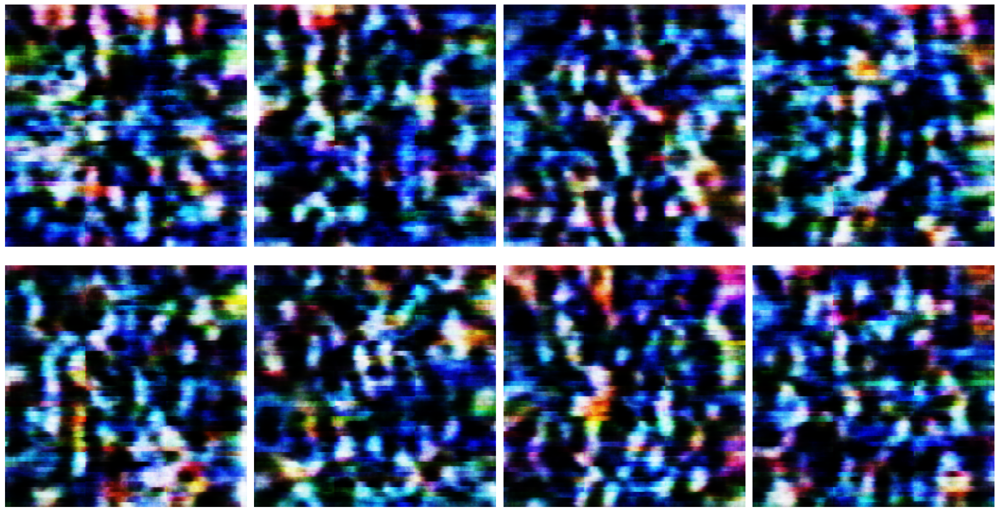

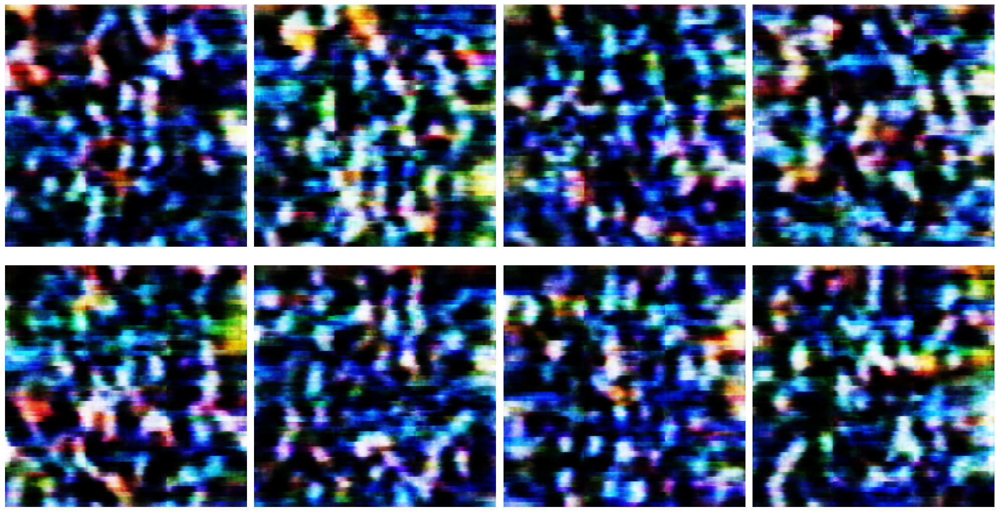

In [76]:
all_hidden_data = encoder.predict(init_data_with_batch_size(1)[0])
mean, std = np.mean(all_hidden_data), np.std(all_hidden_data)
print("mean all_hidden_data (ideal: 0):", mean)
print("std all_hidden_data (ideal: 1):", std)

for _ in range(3):
    num_images = 4

    noise = np.random.normal(mean, std, [num_images*2, *hidden_shape])
    generated_images = np.array(decoder.predict(noise, verbose=False))

    plt.figure(figsize=(20, 11))

    for i in range(num_images):
        # Оригинальное изображение
        plt.subplot(2, num_images, i + 1)

        # Переводим в промежуток [0; 1]
        plt.imshow(generated_images[i + num_images])
        plt.axis("off")

        # Сгенерированное изображение
        plt.subplot(2, num_images, i + num_images + 1)
        plt.imshow(generated_images[i])
        plt.axis("off")
    plt.tight_layout()
    plt.show()

In [80]:
"""Выводим Архитектуру"""
encoder_img = tf.keras.utils.plot_model(encoder, to_file="encoder.png", show_shapes=False, show_layer_names=False,
                                        dpi=128, show_layer_activations=False)

decoder_img = tf.keras.utils.plot_model(decoder, to_file="decoder.png", show_shapes=False, show_layer_names=False,
                                        dpi=128, show_layer_activations=False)